### Object Detection

Imports:

In [2]:
import numpy as np
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torch.utils.data.sampler import SubsetRandomSampler
import torchvision.transforms as transforms
from google.colab import drive
from PIL import Image


In [3]:
import cv2
from google.colab.patches import cv2_imshow

In [4]:
import matplotlib.pyplot as plt

In [5]:
from torchvision.datasets import CocoDetection
from pycocotools.coco import COCO

Use Resnet:

In [6]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn_v2(pretrained = True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_V2_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth
100%|██████████| 167M/167M [00:03<00:00, 55.5MB/s]


In [7]:
model.eval()

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

Mount Google Drive:

In [8]:
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [9]:
path = '/content/gdrive/MyDrive/3rd Year/APS360/Project/images'

Get COCO names:

In [27]:
coco_names_path = '/content/gdrive/MyDrive/3rd Year/APS360/Project/COCO classes/annotations/coco_names.txt'

In [28]:
file = open(coco_names_path, 'r')

data = file.read()

coco_names = data.split("\n")

print(coco_names)

['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 'train', 'truck', 'boat', 'trafficlight', 'firehydrant', 'streetsign', 'stopsign', 'parkingmeter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'hat', 'backpack', 'umbrella', 'shoe', 'eyeglasses', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sportsball', 'kite', 'baseballbat', 'baseballglove', 'skateboard', 'surfboard', 'tennisracket', 'bottle', 'plate', 'wineglass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hotdog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 'bed', 'mirror', 'diningtable', 'window', 'desk', 'toilet', 'door', 'tvmonitor', 'laptop', 'mouse', 'remote', 'keyboard', 'cellphone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'blender', 'book', 'clock', 'vase', 'scissors', 'teddybear', 'hairdrier', 'toothbrush', 'hairbrush']


In [43]:
def output_image_and_bounding_boxes(image, model, class_names, min_score = 0.9):
  '''
    image should be of type numpy

  '''

  transform = transforms.ToTensor()
  imageTensor = transform(image)

  with torch.no_grad():
    pred = model([imageTensor])

  boundingBoxes, labels, scores, = pred[0]["boxes"] , pred[0]["labels"] , pred[0]["scores"]

  numObjects = torch.argwhere(scores > min_score).shape[0]

  font = cv2.FONT_HERSHEY_SIMPLEX

  for i in range(numObjects):
    x1, y1, x2, y2 = boundingBoxes[i].numpy().astype("int")
    class_name = class_names[labels.numpy()[i] - 1]
    image = cv2.rectangle(image, (x1, y1), (x2, y2), (0,255,0), 1)
    image = cv2.putText(image, class_name, (x1, y1), font, 1, (255, 0,0), 1, cv2.LINE_AA)

  cv2_imshow(image)

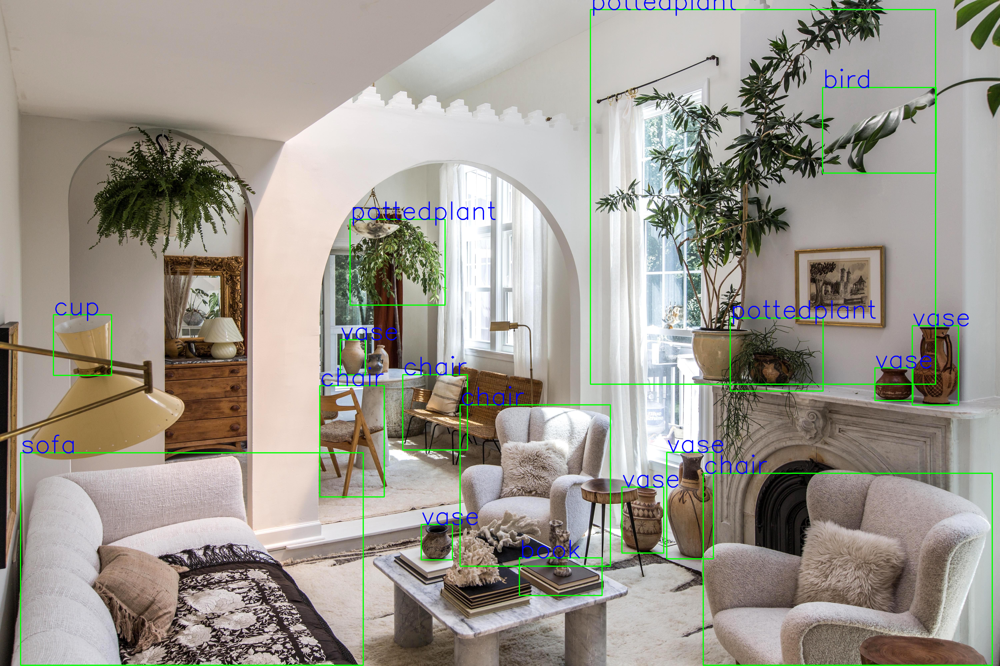

In [41]:
testImage1 = cv2.imread(path + "/testImage1.jpg")


output_image_and_bounding_boxes(testImage1, model, coco_names)

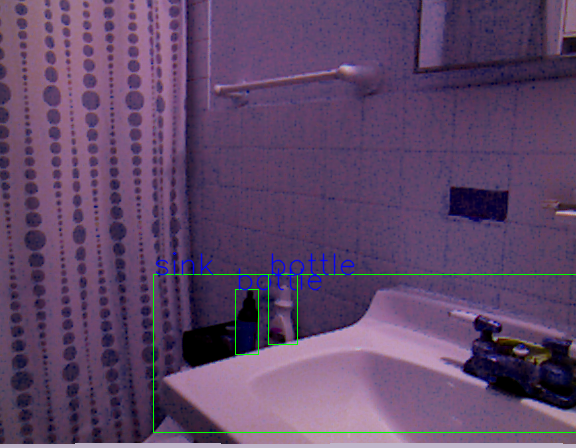

In [44]:
testImage2 = np.load(path + "/testImage2.npy")
output_image_and_bounding_boxes(testImage2, model, coco_names)